# 3. Via 2.0 Cartography on Zebrahub (Visualization)
This tutorial focuses on how to generate the Via2.0 Zebrahub Atlas View. The TI analysis is shown in Tutorial #2  

In [1]:
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import pyVIA.core as via
from datetime import datetime

### Load the data

Data has been filtered and library normalized. 
Data is annotated with time/stage, cluster labels, and cell type labels (coarse and fine)


In [2]:
print(f'{datetime.now()}\tStart reading data')
adata=sc.read_h5ad( filename='/home/user/Trajectory/Datasets/Zebrafish_Lange2023/Rawdata/Zebrahub_data_via.h5ad')
#compute PCA
adata.uns['log1p']['base'] = None #fix for small bug in scanpy #see https://github.com/theislab/single-cell-tutorial/issues/97
sc.pp.highly_variable_genes(adata, n_top_genes=2000)
sc.tl.pca(adata, n_comps=100)
print(adata)

2024-02-06 16:48:28.584723	Start reading data
AnnData object with n_obs × n_vars = 119457 × 28187
    obs: 'n_genes', 'n_counts', 'fish', 'timepoint_cluster', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_nc', 'pct_counts_nc', 'developmental_stage', 'timepoint', 'zebrafish_anatomy_ontology_class', 'zebrafish_anatomy_ontology_id', 'parc', 'kmeans50', 'celltype_extrainfo', 'zebrafish_anatomy_ontology_class_shobi', 'adjusted_timepoint', 'bool_list', 'global annotation', 'time_coarse_cell_type', 'time_fine_cell_type', 'parc_cluster', 'parc_cluster_and_cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'nc', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'global_annotation_colors', 'hvg', 'log1p', 'pca', 'timepoint_colors', 'zebrafish_anatomy_ontology_class_colors', 'zebrafish_anatomy_ontology_id_colors'
    obsm: 'X_U', 'X_Vi

### Extract some annotations

In [3]:
n_cells = adata.shape[0]
print('cells is', n_cells)
parc_cluster = [i for i in adata.obs['parc_cluster']]
parc_cluster_and_cell_type = [i for i in adata.obs['parc_cluster_and_cell_type']]
coarse_cell_type = [i for i in adata.obs['zebrafish_anatomy_ontology_class']]
fine_cell_type = [i for i in adata.obs['zebrafish_anatomy_ontology_class_shobi']] #consolidated annotaions from individual time point files
coarse_fine_cell_type = [coarse_cell_type[i] + fine_cell_type[i] for i in range(n_cells)]
time_point_numeric = [i for i in adata.obs['adjusted_timepoint']] #assigned a numeric value to each stage (e.g. 5hpf is 5, 10hpf is 10,...)
early_cell_type = [i if str(i) != 'nan' else '' for i in adata.obs['global annotation']]

hybrid_cell_time = [str(fine_cell_type[i]) + '_'+early_cell_type[i]+'_'+str(time_point_numeric[i]) for i in range(n_cells)] #labels of early stage cells which was provided for cells <24hpf also included
parc_numeric_cluster_labels = [i for i in adata.obs['parc']]
parc_cluster = [i for i in adata.obs['parc_cluster']]

cells is 119457


### Find a suitable root

In [4]:
root_str = 'paraxial mesoderm_Somites_0'
loc_root = np.where(np.asarray(hybrid_cell_time) == root_str)[0] #'paraxial mesoderm_PSM_0' 1 cell , 'paraxial mesoderm_Somites_0' has 51 cells, 'paraxial mesoderm_Muscle_0', 'tail bud_NMPs_0'
root = [loc_root[0]]
n_pcs = 100
print(f'{datetime.now()}\troot is cell number  {root[0]} of type {fine_cell_type[root[0]]}')

2024-02-06 16:49:16.395417	root is cell number  2604 of type paraxial mesoderm


### Initialize parameters

In [5]:
knn=30
time_series = True  # True
memory = 10
jac_std_global = 1  # 1 is used in all the umap csv files
random_seed = 0#1  # 0
knn_sequential = 15  # 5 forviagraphs #15 for embedding
t_diff_step = 2
do_gaussian_kernel_edgeweights = False
edgebundle_pruning_twice = True
edgepruning_clustering_resolution = 0.15  # 0.15 viagraph and embedding
edgebundle_pruning = 0.05  # 0.15
neighboring_terminal_states_threshold = 4  # 3
viagraph_decay = 0.6  # 0.7, 0.9
max_vis_out = 2

### Set terminal states (optional)

In [6]:
# The parameter "user_defined_terminal_group" is being set to a list of group level annotations corresponding to the provided true_label. These were terminal fates detected in previous runs and saved for reproducability.
# This parameter can also be left to its default user_defined_terminal_group = []. the results should be similar.
user_defined_cellfates= ['0_cartilage element', '2_dermis', '49_fin',
                                          '67_pharyngeal arch', '120_cranial cartilage',
                                          '1_forebrain', '71_neuron', '89_diencephalon',
                                          '136_radial glial cell',
                                          '10_epidermal cell', '83_neuromast', 
                                          '145_enteric musculature', '55_myotome', 
                                          '46_hematopoietic cell',                                          '102_vasculature', '127_Muller cell', '105_oligodendrocyte',                            '69_liver', '90_pharynx',
                                          '95_intestine']

### Initialize and Run the Via2.0 Class

In [7]:
# Initialize and Run the Via2.0 Class
print(f'{datetime.now()}\tRun Via2.0')

v0 = via.VIA(adata.obsm['X_pca'][:, 0:n_pcs], true_label=parc_cluster_and_cell_type, 
             labels=parc_cluster, knn=knn, memory=memory,
             user_defined_terminal_group=user_defined_cellfates,
             edgepruning_clustering_resolution=edgepruning_clustering_resolution,
             neighboring_terminal_states_threshold=neighboring_terminal_states_threshold,
             too_big_factor=0.3, resolution_parameter=1,
             root_user=root, dataset='', random_seed=random_seed,
             is_coarse=True, preserve_disconnected=False, pseudotime_threshold_TS=40, x_lazy=0.99,
             do_gaussian_kernel_edgeweights=do_gaussian_kernel_edgeweights,
             alpha_teleport=0.99, edgebundle_pruning=edgebundle_pruning, edgebundle_pruning_twice=True,
             time_series=time_series, time_series_labels=time_point_numeric, knn_sequential=knn_sequential,
             knn_sequential_reverse=knn_sequential, t_diff_step=t_diff_step,
             do_compute_embedding=False)

v0.run_VIA()


2024-02-06 16:49:16.446582	Run Via2.0
2024-02-06 16:49:16.453681	Running VIA over input data of 119457 (samples) x 100 (features)
2024-02-06 16:49:16.453681	Knngraph has 30 neighbors
2024-02-06 16:49:49.943120	Using time series information to guide knn graph construction 
2024-02-06 16:49:49.954230	Time series ordered set [0, 5, 10, 15, 20, 25, 30, 35, 40, 45]
2024-02-06 16:50:36.547252	Shape neighbors (119457, 30) and sequential neighbors (119457, 30)
2024-02-06 16:50:36.600487	Shape augmented neighbors (119457, 60)
2024-02-06 16:50:36.651840	Actual average allowable time difference between nodes is 10.0
2024-02-06 16:50:55.131081	Finished global pruning of 30-knn graph used for clustering at level of 0.15. Kept 46.9 % of edges. 
2024-02-06 16:50:55.445815	Number of connected components used for clustergraph  is 1
2024-02-06 16:51:17.750064	Using predfined labels provided by user (this must be provided as an array)
2024-02-06 16:51:17.750064	Making cluster graph. Global cluster graph 

C:\Users\Kevin tsia\anaconda3\envs\via2\lib\site-packages\scipy\sparse\_index.py:103: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


2024-02-06 16:51:20.255203	The root index, 2604 provided by the user belongs to cluster number 97 and corresponds to cell type 97_paraxial mesoderm
2024-02-06 16:51:20.404829	Computing lazy-teleporting expected hitting times
2024-02-06 16:51:31.983877	 ended all multiprocesses, will retrieve and reshape
try rw2 hitting times setup
start computing walks with rw2 method
g.indptr.size, 147


C:\Users\Kevin tsia\anaconda3\envs\via2\lib\site-packages\pecanpy\graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|                                                        | 0/1300 [00:00<?, ?it/s]

memory for rw2 hittings times  2. Using rw2 based pt
do scaling of pt
2024-02-06 16:51:41.963854	Terminal cluster list based on user defined cells/groups: [('0_cartilage element', 0), ('2_dermis', 2), ('49_fin', 49), ('67_pharyngeal arch', 67), ('120_cranial cartilage', 120), ('1_forebrain', 1), ('71_neuron', 71), ('89_diencephalon', 89), ('136_radial glial cell', 136), ('10_epidermal cell', 10), ('83_neuromast', 83), ('145_enteric musculature', 145), ('55_myotome', 55), ('46_hematopoietic cell', 46), ('102_vasculature', 102), ('127_Muller cell', 127), ('105_oligodendrocyte', 105), ('69_liver', 69), ('90_pharynx', 90), ('95_intestine', 95)]
2024-02-06 16:51:41.963854	Terminal clusters corresponding to unique lineages in this component are [0, 2, 49, 67, 120, 1, 71, 89, 136, 10, 83, 145, 55, 46, 102, 127, 105, 69, 90, 95] 
TESTING rw2_lineage probability at memory 10
testing rw2 lineage probability at memory 10
g.indptr.size, 147


C:\Users\Kevin tsia\anaconda3\envs\via2\lib\site-packages\pecanpy\graph.py:90: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  warnings.warn(


  0%|                                                        | 0/1000 [00:00<?, ?it/s]

2024-02-06 16:51:48.486988	 Cluster or terminal cell fate 0 is reached 265.0 times
2024-02-06 16:51:48.683785	 Cluster or terminal cell fate 2 is reached 321.0 times
2024-02-06 16:51:48.923914	 Cluster or terminal cell fate 49 is reached 38.0 times
2024-02-06 16:51:49.118724	 Cluster or terminal cell fate 67 is reached 326.0 times
2024-02-06 16:51:49.340747	 Cluster or terminal cell fate 120 is reached 169.0 times
2024-02-06 16:51:49.568767	 Cluster or terminal cell fate 1 is reached 65.0 times
2024-02-06 16:51:49.816750	 Cluster or terminal cell fate 71 is reached 45.0 times
2024-02-06 16:51:50.007561	 Cluster or terminal cell fate 89 is reached 417.0 times
2024-02-06 16:51:50.233503	 Cluster or terminal cell fate 136 is reached 116.0 times
2024-02-06 16:51:50.461331	 Cluster or terminal cell fate 10 is reached 71.0 times
2024-02-06 16:51:50.692439	 Cluster or terminal cell fate 83 is reached 30.0 times
2024-02-06 16:51:50.925563	 Cluster or terminal cell fate 145 is reached 116.0 tim

C:\Users\Kevin tsia\anaconda3\envs\via2\lib\site-packages\scipy\sparse\_index.py:103: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


2024-02-06 16:52:05.635522	Hammer dims: Nodes shape: (146, 2) Edges shape: (890, 3)
2024-02-06 16:52:05.853588	Time elapsed 143.6 seconds


### Computing the Atlas View
>Set parameter **init_pos**
>- 'via' : uses via graph to initialize embedding
>- 'spectral' : uses normalized Laplacian of the fuzzy 1-skeleton
>- n_cell x 2 dimensional array preset by the user

Once you have the single cell atlas embedding, you can compute the edge layout and generate the full Atlas View

In [8]:
compute_atlas_embedding = True
if compute_atlas_embedding:
    # STEP 3
    print(f'{datetime.now()}\tStart Atlas embedding computation')
    atlas_embedding = via.via_atlas_emb(via_object=v0, init_pos='via', min_dist=0.2)
else: atlas_embedding = embedding=adata.obsm['X_Via2_Atlas'] #use pre-saved embedding

v0.embedding = atlas_embedding #remember to pass this onto the via_object

2024-02-06 16:52:05.878707	Start Atlas embedding computation
X-input (119457, 100)
len membership and n_cells 119457 119457
n cell 119457
2024-02-06 16:52:05.878707	Computing embedding on sc-Viagraph
2024-02-06 16:52:10.671518	using via cluster graph to initialize embedding
(119457, 100)


  0%|          | 0/100 [00:00<?, ?it/s]

	completed  0  /  100 epochs
	completed  10  /  100 epochs
	completed  20  /  100 epochs
	completed  30  /  100 epochs
	completed  40  /  100 epochs
	completed  50  /  100 epochs
	completed  60  /  100 epochs
	completed  70  /  100 epochs
	completed  80  /  100 epochs
	completed  90  /  100 epochs


### Re-orient (optional)
If you want to apply a rotation transformation on the embedding

#re-orient/rotate. This can be skipped.  Only use it if neceseary First plot out the atlas_embedding (code in next snipped) and see if you want to rotate it so the early cells are on the LHS. 
import math
theta_deg = 180
theta_radians = math.sin(math.radians(theta_deg))
R = np.array([[math.cos(theta_radians), -math.sin(theta_radians)],[math.sin(theta_radians),math.cos(theta_radians)]])
atlas_embedding_ = np.matmul(R,atlas_embedding.T)
atlas_embedding_=atlas_embedding.T
v0.embedding = atlas_embedding_

### Plot Atlas Embedding'

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


2024-02-06 17:02:03.305009	Plot Atlas Embedding


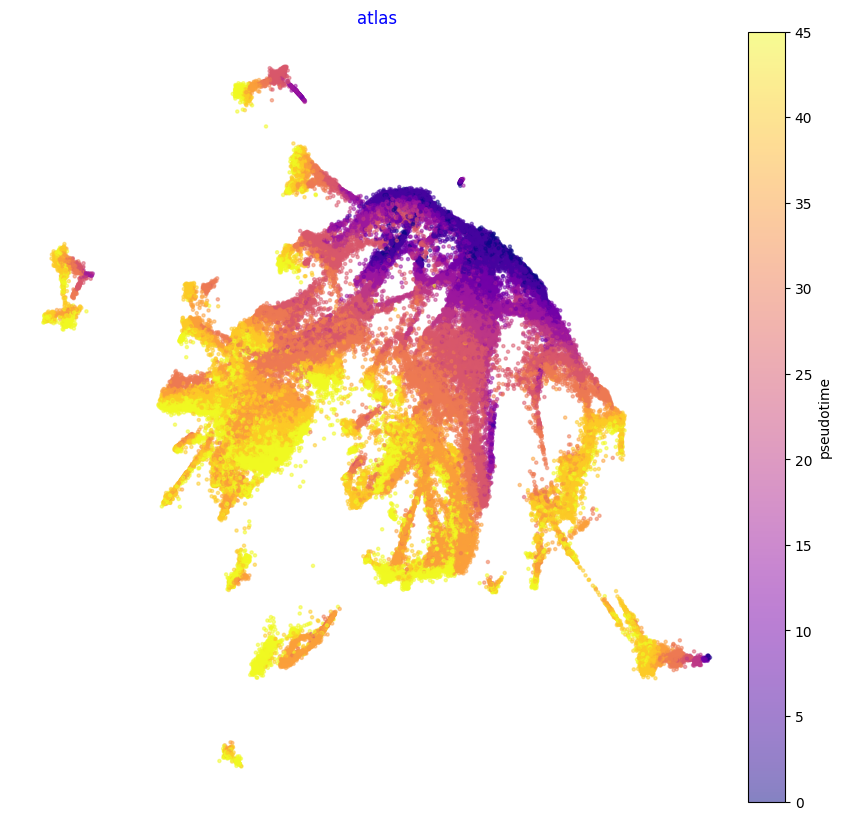

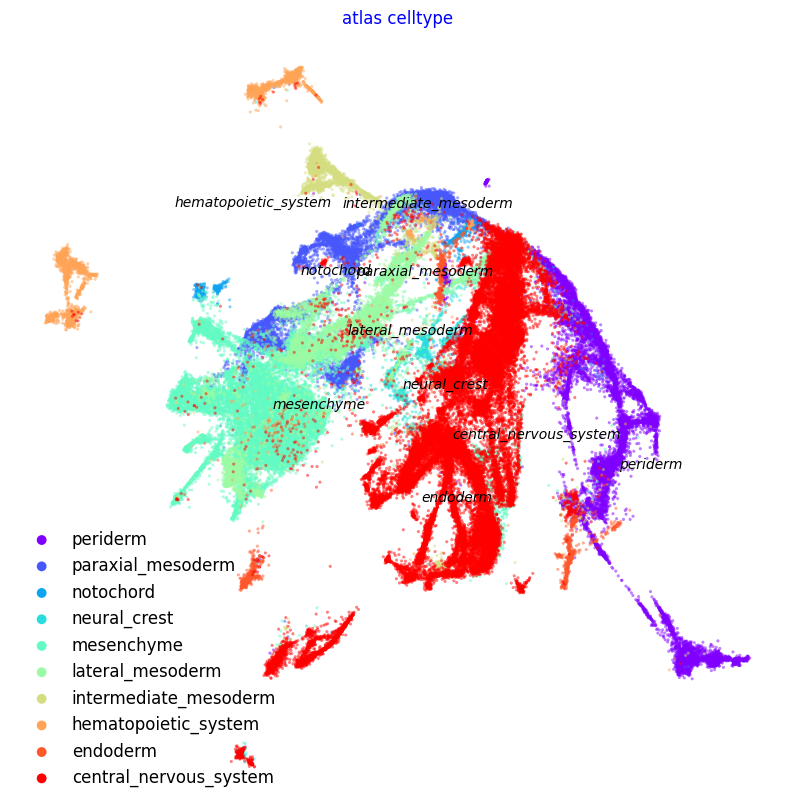

In [10]:
print(f'{datetime.now()}\tPlot Atlas Embedding')
f1, ax = via.plot_scatter(embedding=atlas_embedding, labels=time_point_numeric, cmap='plasma', s=5,
                          alpha=0.5, edgecolors='None',
                          title='atlas', text_labels=False)
f1.set_size_inches(10, 10)

f2, ax = via.plot_scatter(embedding=atlas_embedding, labels=coarse_cell_type, title='atlas celltype',
                          alpha=0.5, s=5)
f2.set_size_inches(10, 10)
plt.show()

### Atlas View Edges
1. Compute the edges and pass it onto the via_object to avoid recomputing each time you plot

In [11]:
print(f'{datetime.now()}\tStart Computing Atlas View')
dict_coarse = {'notochord':2.5, 'central_nervous_system':5.5,'neural_crest':4.5,'paraxial_mesoderm':0,'intermediate_mesoderm':1,'lateral_mesoderm':1.5,
                       'mesenchyme':2.0,'hematopoietic_system':0.5,'periderm':8,'endoderm':7}
decay = 0.55#0.7  # increasing decay increasing merging of edges
i_bw = 0.035#0.05  # increasing bw increases merging of edges
global_visual_pruning = 0.55
n_milestones = 300

hammerbundle_dict = via.make_edgebundle_milestone(via_object=v0, n_milestones=n_milestones, decay=decay,
                                                  initial_bandwidth=i_bw,
                                                  global_visual_pruning=global_visual_pruning,
                                                  sc_labels_numeric=time_point_numeric)
v0.hammerbundle_milestone_dict = hammerbundle_dict  # make the hmbd in one shot to be used for all plots



2024-02-06 17:02:15.718628	Start Computing Atlas View
2024-02-06 17:02:15.718628	Start finding milestones
2024-02-06 17:02:50.911185	End milestones with 300
2024-02-06 17:02:52.349099	Recompute weights
2024-02-06 17:02:52.414034	pruning milestone graph based on recomputed weights
2024-02-06 17:02:52.417055	Graph has 1 connected components before pruning
2024-02-06 17:02:52.419138	Graph has 1 connected components after pruning
2024-02-06 17:02:52.419138	Graph has 1 connected components after reconnecting
2024-02-06 17:02:52.425153	regenerate igraph on pruned edges
2024-02-06 17:02:52.757955	Setting numeric label as time_series_labels or other sequential metadata for coloring edges
2024-02-06 17:02:53.431797	Making smooth edges


2024-02-06 17:03:23.164984	Plot Atlas View
inside add sc embedding second if


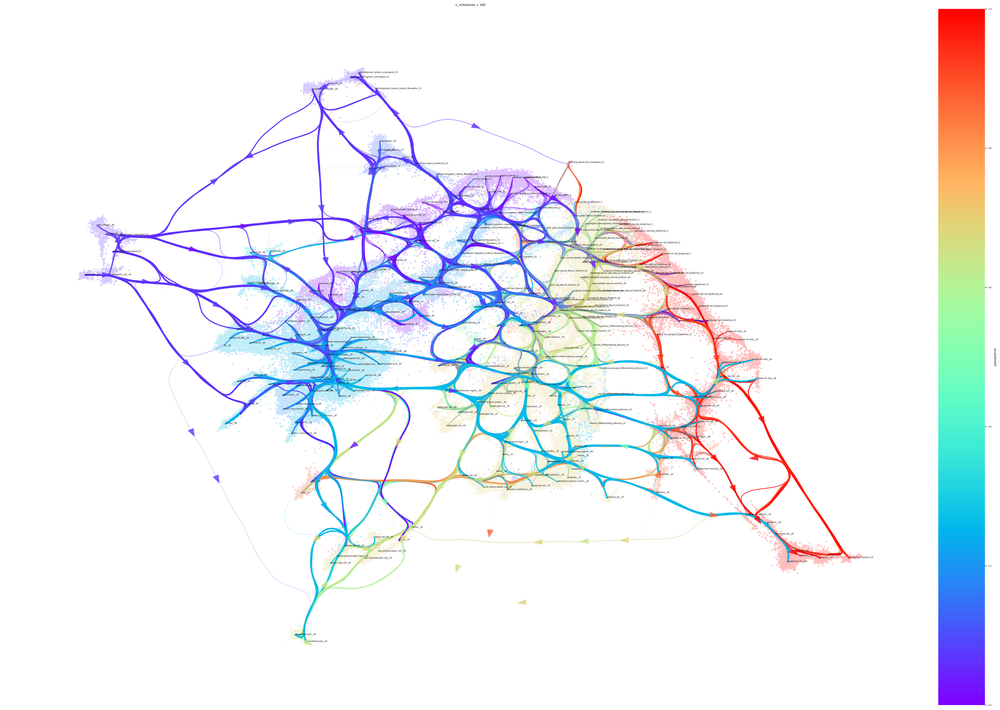

In [12]:
print(f'{datetime.now()}\tPlot Atlas View')
# color by tissue type, we 
color_dict = {'notochord': 2.5, 'central_nervous_system': 5.5, 'neural_crest': 4.5, 'paraxial_mesoderm': 0,
               'intermediate_mesoderm': 1, 'lateral_mesoderm': 1.5,
               'mesenchyme': 2.0, 'hematopoietic_system': 0.5, 'periderm': 8, 'endoderm': 7}

#color by major cell type
headwidth_bundle = 0.2
fig, ax = via.plot_atlas_view(via_object=v0, sc_labels=hybrid_cell_time, fontsize_labels=4, text_labels=True,
                              add_sc_embedding=True, sc_scatter_alpha=0.25, sc_scatter_size=5, 
                              cmap='rainbow', linewidth_bundle=3, 
                              sc_labels_expression=[color_dict[coarse_cell_type[i]] for i in range(len(v0.labels))], 
                              headwidth_bundle=headwidth_bundle)
fig.set_size_inches(35, 25)

plt.show()

inside add sc embedding second if


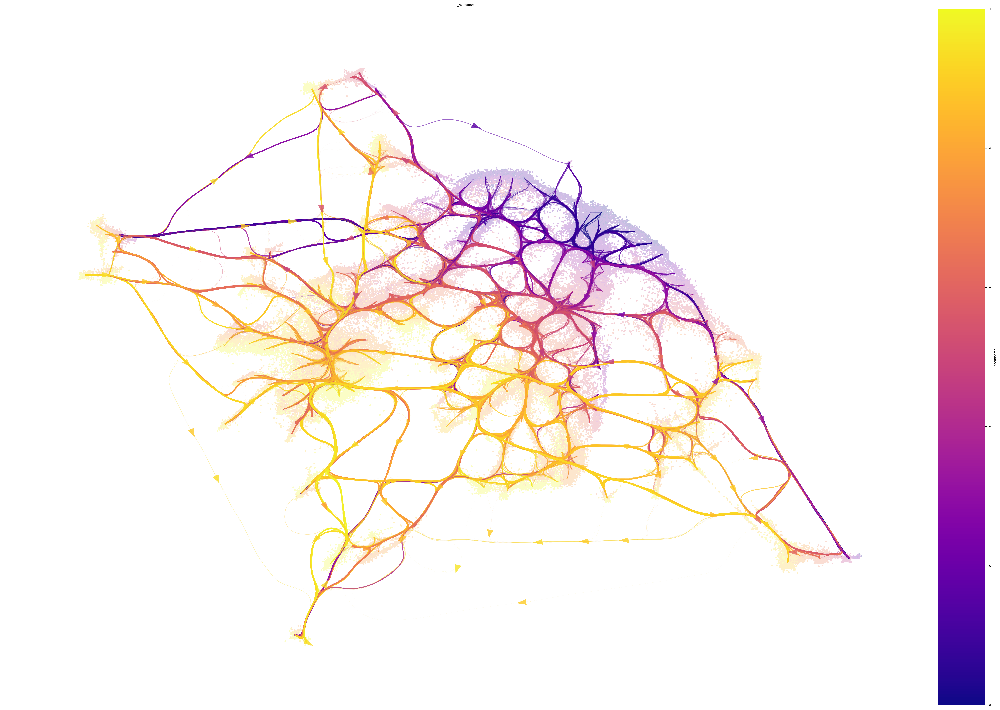

In [13]:
#if you want to color by categories (e.g. tissue type)
#autogenerate color_dict 
#color_dict = {}
#set_labels = list(set(labels))
#set_labels.sort(reverse=True)
#for index, value in enumerate(set_labels): color_dict[value] = index

#color by stage
fig2, ax2 = via.plot_atlas_view(via_object=v0, sc_labels=hybrid_cell_time, fontsize_labels=2, text_labels=False,
                                add_sc_embedding=True, sc_scatter_alpha=0.25, sc_scatter_size=5, cmap='plasma',
                                sc_labels_expression=time_point_numeric,
                                linewidth_bundle=3, 
                                headwidth_bundle=headwidth_bundle)
fig2.set_size_inches(35, 25)